# Lab13_108032053

## 1. Load data

In [1]:
import tensorflow as tf
import tensorflow.keras as keras
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import imageio
import moviepy.editor as mpy
import cv2
from IPython.display import display, Image
import time

import os 
os.environ['TF_ENABLE_AUTO_MIXED_PRECISION'] = '0'
os.environ['TF_XLA_FLAGS'] = '--tf_xla_auto_jit=2 --tf_xla_cpu_global_jit'

2023-12-12 12:31:43.957722: I tensorflow/core/platform/cpu_feature_guard.cc:183] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE3 SSE4.1 SSE4.2 AVX, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
DATA_DIR = './img_align_celeba_png'
IMAGE_SIZE = 64
BATCH_SIZE = 128
BUFFER_SIZE = 5000

Z_DIM = 128
IMAGE_SHAPE = (IMAGE_SIZE, IMAGE_SIZE, 3)

LEARNING_RATE = 1e-4
LAMBDA = 10
EPOCHS = 100
EPOCHS_PER_CKPT = 5
N_CRITIC = 3

SAMPLE_ROW = 8
SAMPLE_COL = 8
SAMPLE_NUM = SAMPLE_ROW * SAMPLE_COL
SAMPLE_DURATION = 10

In [31]:
# Utility function
def generate_img(imgs, row, col, path=None):
    h, w, c = imgs[0].shape
    out = np.zeros((h * row, w * col, c), dtype=np.uint8)
    for n, img in enumerate(imgs):
        j, i = divmod(n, col)
        out[j * h : (j + 1) * h, i * w : (i + 1) * w, :] = img
    if path is not None: 
        imageio.imwrite(path, out)
    return out
  
def generate_gif(imgs_path_list, fname, duration):
    imgs = []
    for img_path in imgs_path_list:
        img = imageio.imread(img_path)
        img_id = img_path.split('/')[-1].split('.')[0]
        
        img_with_id = imageio.core.util.Array(np.concatenate([np.ones((20, img.shape[1], 3), dtype=np.uint8) * 255, img], axis=0))
        img_with_id[:20, :, :] = 0
        img_with_id[:20, :, 0] = 255
        img_with_id[:20, :, 1] = 255
        img_with_id[:20, :, 2] = 255
        img_with_id[:20, :, :] = cv2.putText(img_with_id[:20, :, :], f'EPOCH: {img_id}', (10, 15), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
        
        imgs.append(img_with_id)
        
    n = float(len(imgs)) / duration
    clip = mpy.VideoClip(lambda t: imgs[int(n * t)], duration=duration)
    clip.write_gif(fname, fps=n)

2023-12-12 12:47:58.186638: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1636] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 31136 MB memory:  -> device: 0, name: Tesla V100-SXM2-32GB, pci bus id: 0000:b2:00.0, compute capability: 7.0


1582


2023-12-12 12:49:35.875531: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7f2e38001f20 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2023-12-12 12:49:35.875562: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version
2023-12-12 12:49:35.931671: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
2023-12-12 12:49:45.727811: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] Filling up shuffle buffer (this may take a while): 1765 of 5000
2023-12-12 12:49:55.727104: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] Filling up shuffle buffer (this may take a while): 3536 of 5000
2023-12-12 12:50:03.895107: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] Shuffle buffer filled.


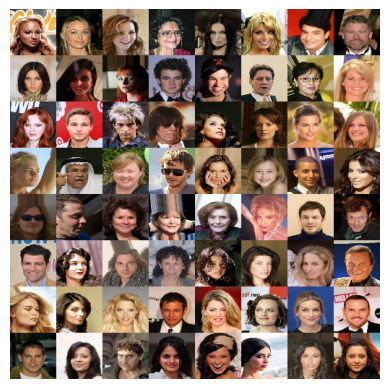

In [16]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_png(img, channels=3)
    img = tf.image.resize(img, (IMAGE_SIZE, IMAGE_SIZE))
    img = tf.cast(img, tf.float32)
    img = (img / 255) * 2 - 1
    return img

dataset = tf.data.Dataset.list_files(f'{DATA_DIR}/*.png')
dataset = dataset.map(load_image)
dataset = dataset.shuffle(BUFFER_SIZE)
dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

num_steps = len(dataset)
print(num_steps)

# Show image
imgs = next(iter(dataset))
imgs = tf.clip_by_value((imgs[:SAMPLE_NUM] + 1) / 2 * 255, 0, 255)
img = generate_img(imgs, SAMPLE_ROW, SAMPLE_COL)
plt.imshow(img)
plt.axis("off")
plt.show()

# 2. Define model

In [5]:
def GAN_generator(input_z_shape=Z_DIM):

    inputs = keras.layers.Input(input_z_shape)
    
    x = keras.layers.Dense(8192, use_bias=False)(inputs)
    x = keras.layers.Reshape((4, 4, 512))(x)
    
    x = keras.layers.Conv2DTranspose(
        512, 
        (4, 4), 
        strides=(1, 1), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2DTranspose(
        256, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2DTranspose(
        128, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2DTranspose(
        64, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.LeakyReLU()(x)
    
    outputs = keras.layers.Conv2DTranspose(
        3, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        activation='tanh', 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    
    model = keras.Model(inputs=inputs, outputs=outputs, name='generator')
    
    return model

generator = GAN_generator()
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128)]             0         
                                                                 
 dense (Dense)               (None, 8192)              1048576   
                                                                 
 reshape (Reshape)           (None, 4, 4, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 4, 4, 512)         4194304   
 anspose)                                                        
                                                                 
 batch_normalization (Batch  (None, 4, 4, 512)         2048      
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 4, 4, 512)         0 

In [6]:
def GAN_discriminator(input_x_shape=IMAGE_SHAPE):

    inputs = keras.layers.Input(input_x_shape)
    
    x = keras.layers.Conv2D(
        64, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(inputs)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2D(
        128, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2D(
        256, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2D(
        512, 
        (4, 4), 
        strides=(2, 2), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    x = keras.layers.LeakyReLU()(x)
    
    x = keras.layers.Conv2D(
        1, 
        (4, 4), 
        strides=(1, 1), 
        padding='same', 
        use_bias=False, 
        kernel_initializer=keras.initializers.RandomNormal(mean=0.0, stddev=0.02), 
    )(x)
    
    x = keras.layers.Flatten()(x)
    
    output = keras.layers.Dense(1)(x)
    
    model = keras.Model(inputs=inputs, outputs=output, name='discriminator')
    
    return model

discriminator = GAN_discriminator()
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d (Conv2D)             (None, 32, 32, 64)        3072      
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       131072    
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_2 (Conv2D)           (None, 8, 8, 256)         524288    
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 8, 8, 256)       

In [7]:
optimizer_g = keras.optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=0.5)
optimizer_d = keras.optimizers.Adam(learning_rate=LEARNING_RATE, beta_1=0.5)

In [8]:
checkpoint_path = './ckpt'

ckpt = tf.train.Checkpoint(generator=generator,
                           discriminator=discriminator,
                           optimizer_g=optimizer_g,
                           optimizer_d=optimizer_d)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

start_epoch = 1
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    latest_ckpt = int(ckpt_manager.latest_checkpoint.split('-')[-1])
    start_epoch = EPOCHS_PER_CKPT * latest_ckpt + 1
    print(f'Restore from latest checkpoint: {ckpt_manager.latest_checkpoint.split("/")[-1]}')
    
print(f'Start epoch: {start_epoch}')

Start epoch: 1


## 3. Training

In [9]:
loss_x_list = []
loss_g_list = []
loss_d_list = []

In [10]:
@tf.function
def train_step_g(real_img):
    input_g = tf.random.normal([BATCH_SIZE, Z_DIM])
    
    with tf.GradientTape() as tape_g:
        fake_img = generator(input_g, training=True)
        fake_pred = discriminator(fake_img, training=True)
        loss_g = -tf.reduce_mean(fake_pred)
        
    gradient_g = tape_g.gradient(loss_g, generator.trainable_variables)
    optimizer_g.apply_gradients(zip(gradient_g, generator.trainable_variables))
    
    return loss_g
    
@tf.function
def train_step_d(real_img):
    input_g = tf.random.normal([BATCH_SIZE, Z_DIM])
    epsilon = tf.random.uniform(shape=[BATCH_SIZE, 1, 1, 1], minval=0, maxval=1)
    
    with tf.GradientTape() as tape_d:
        with tf.GradientTape() as tape_gp:
            fake_img = generator(input_g, training=True)
            fake_img_gp = epsilon * real_img + (1 - epsilon) * fake_img
            fake_pred_gp = discriminator(fake_img_gp, training=True)
        
        gradient_gp = tape_gp.gradient(fake_pred_gp, fake_img_gp)
        gradient_norm_gp = tf.sqrt(tf.reduce_sum(tf.square(gradient_gp), axis=np.arange(1, len(gradient_gp.shape))))
        gradient_penalty = tf.reduce_mean(tf.square(gradient_norm_gp - 1))
        
        fake_pred = discriminator(fake_img, training=True)
        real_pred = discriminator(real_img, training=True)
        
        loss_d = tf.reduce_mean(fake_pred) - tf.reduce_mean(real_pred) + LAMBDA * gradient_penalty
    
    gradient_d = tape_d.gradient(loss_d, discriminator.trainable_variables)
    optimizer_d.apply_gradients(zip(gradient_d, discriminator.trainable_variables))
    
    return loss_d

  0%|          | 0/1582 [00:00<?, ?it/s]2023-12-12 04:19:02.066727: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] Filling up shuffle buffer (this may take a while): 1789 of 5000
2023-12-12 04:19:12.064328: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] Filling up shuffle buffer (this may take a while): 3613 of 5000
2023-12-12 04:19:19.504787: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:450] Shuffle buffer filled.
2023-12-12 04:19:21.338726: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x5573519e7280 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-12-12 04:19:21.338782: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Tesla V100-SXM2-32GB, Compute Capability 7.0
2023-12-12 04:19:21.355716: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-12-12 04:19:21.4

2/2 [==============================] - 1s 4ms/step
Epoch 1: Loss_g 26.09443, Loss_d -7.17836


100%|██████████| 1582/1582 [03:29<00:00,  7.55it/s]

2/2 [==============================] - 0s 3ms/step


Epoch 2: Loss_g 8.30979, Loss_d -6.29611


100%|██████████| 1582/1582 [02:27<00:00, 10.74it/s]

2/2 [==============================] - 0s 2ms/step


Epoch 3: Loss_g 3.41017, Loss_d -6.74353


100%|██████████| 1582/1582 [02:23<00:00, 10.99it/s]

2/2 [==============================] - 0s 2ms/step


Epoch 4: Loss_g -3.64703, Loss_d -6.19027


100%|██████████| 1582/1582 [02:26<00:00, 10.81it/s]


2/2 [==============================] - 0s 3ms/step


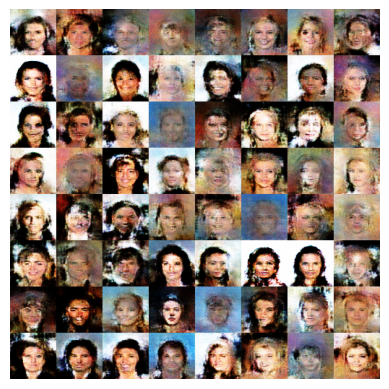

Epoch 5: Loss_g -5.51907, Loss_d -5.83601


100%|██████████| 1582/1582 [02:24<00:00, 10.94it/s]

2/2 [==============================] - 0s 4ms/step


Epoch 6: Loss_g 7.55618, Loss_d -6.78992


 77%|███████▋  | 1220/1582 [01:52<00:43,  8.35it/s]

In [11]:
start = time.time()

sample_inputs = tf.random.normal([SAMPLE_NUM, Z_DIM])

for epoch in range(start_epoch, EPOCHS + 1):
    
    loss_g = 0
    loss_d = 0
    
    # Train step
    for step, img in tqdm(enumerate(dataset), total=num_steps):
        if step % (N_CRITIC + 1) == N_CRITIC - 1:
            loss_g += train_step_g(img)
            # Store data to list
            loss_x_list.append(epoch + step / num_steps)
            loss_g_list.append(loss_g / 1)
            loss_d_list.append(loss_d / N_CRITIC)
            loss_g = 0
            loss_d = 0
        else:
            loss_d += train_step_d(img)
    
    # Save checkpoint
    if epoch % EPOCHS_PER_CKPT == 0:
        ckpt_manager.save()
    
    # Generate sample image
    sample_imgs = generator.predict(sample_inputs)
    sample_imgs = tf.clip_by_value((sample_imgs + 1) / 2 * 255, 0, 255)
    img = generate_img(sample_imgs, SAMPLE_ROW, SAMPLE_COL, f'imgs/{epoch:>04d}.png')
    
    # Display sample image
    if epoch % 5 == 0:
        plt.imshow(img)
        plt.axis("off")
        plt.show()
    
    print(f'Epoch {epoch}: Loss_g {loss_g_list[-1]:.5f}, Loss_d {loss_d_list[-1]:.5f}')
    
print (f'Time taken for {EPOCHS} epoch: {time.time() - start} sec')

## 4. Result

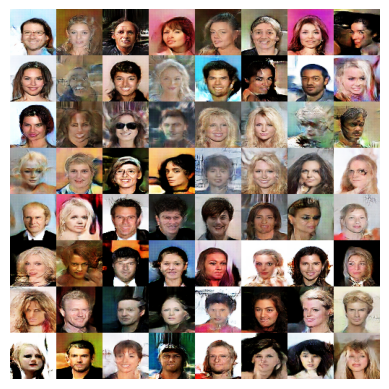

In [26]:
# Display the result
img = tf.io.read_file('imgs/0100.png')
img = tf.image.decode_png(img, channels=3)
plt.imshow(img)
plt.axis("off")
plt.show()

MoviePy - Building file imgs/wgan-gp.gif with imageio.


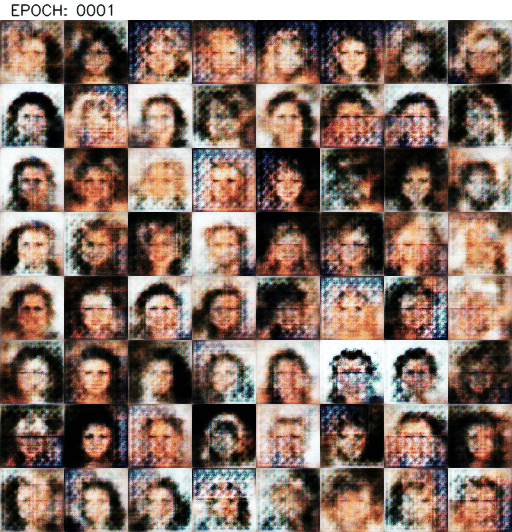

In [32]:
# Generate the GIF
imgs_path_list = [f'imgs/{i:>04d}.png' for i in range(1, EPOCHS + 1)]
generate_gif(imgs_path_list, 'imgs/wgan-gp.gif', duration=SAMPLE_DURATION)

# Display the GIF
display(Image(filename='imgs/wgan-gp.gif'))

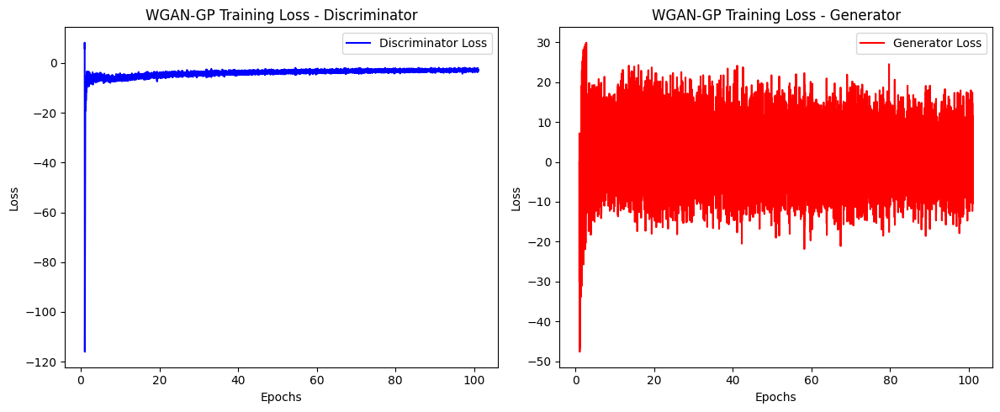

In [25]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

# Plot the discriminator loss
axs[0].plot(loss_x_list, loss_d_list, color='blue', label='Discriminator Loss')
axs[0].legend(loc='upper right')
axs[0].set_xlabel('Epochs')
axs[0].set_ylabel('Loss')
axs[0].set_title('WGAN-GP Training Loss - Discriminator')

# Plot the generator loss
axs[1].plot(loss_x_list, loss_g_list, color='red', label='Generator Loss')
axs[1].legend(loc='upper right')
axs[1].set_xlabel('Epochs')
axs[1].set_ylabel('Loss')
axs[1].set_title('WGAN-GP Training Loss - Generator')

plt.tight_layout()
plt.show()

## 5. Report

在model的部分，我參考了 [wgan-gp-tensorflow](https://github.com/henry32144/wgan-gp-tensorflow/tree/master)，在generator中採用了4組Conv2DTranspose，每一組間都加上BatchNormalization，discriminator中則是採用了4組Conv2D。

而在discriminator的training step中，將原先把gradient clip的動作改成增加一個gradientTape來取得所有f(x)的gradient，並依照WGAN-GP的loss function，對其依順序取norm、減掉1、平方、reduce sum後再乘上一個hyperparameter lambda後加進loss_d中，作為f(x)的gradient大於1時的penalty，讓f(x)的gradient絕對值盡量小於1，符合f必須是1-Lipschitz的假設。

接著在實際training中，我每train 3次的discriminator，就train 1次的generator，次的單位為batch，因此在最後的loss curve中的每個epoch中都會有很多個loss點，而不是1個epoch記一次loss，圖中可以看到discriminator的loss除了一開始的劇烈震盪外，之後就慢慢的增加收斂了，而generator的loss則是維持在一個區間中不停震盪。

在100個epoch的訓練中，可以從GIF圖中看出生成圖片的變化，從0-50 epoch可以看到圖片中的人臉品質在漸漸地變好，50-100 epoch後則是變化不大，只有背景稍微變化。

GIF link: https://drive.google.com/file/d/1gJdTpFuP1dcHLLwiHp7DhAK9BmUOh17d/view?usp=sharing